In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [39]:
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow

In [40]:
# Reading images
img_path = "/content/drive/MyDrive/"
obj_img_name = "obj_book.webp"
scene_img_name = "books_scene.jpg"
obj_img = cv.imread(img_path + obj_img_name, cv.IMREAD_COLOR)
scene_img = cv.imread(img_path + scene_img_name, cv.IMREAD_COLOR)

In [41]:
# Detect feature points and compute descriptors
sift = cv.SIFT_create()
brief = cv.xfeatures2d.BriefDescriptorExtractor_create()

obj_fp = sift.detect(obj_img, None)
scene_fp = sift.detect(scene_img, None)

obj_fp, obj_descr = brief.compute(obj_img, obj_fp)
scene_fp, scene_descr = brief.compute(scene_img, scene_fp)

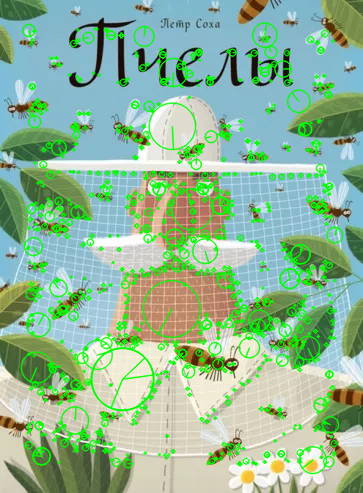

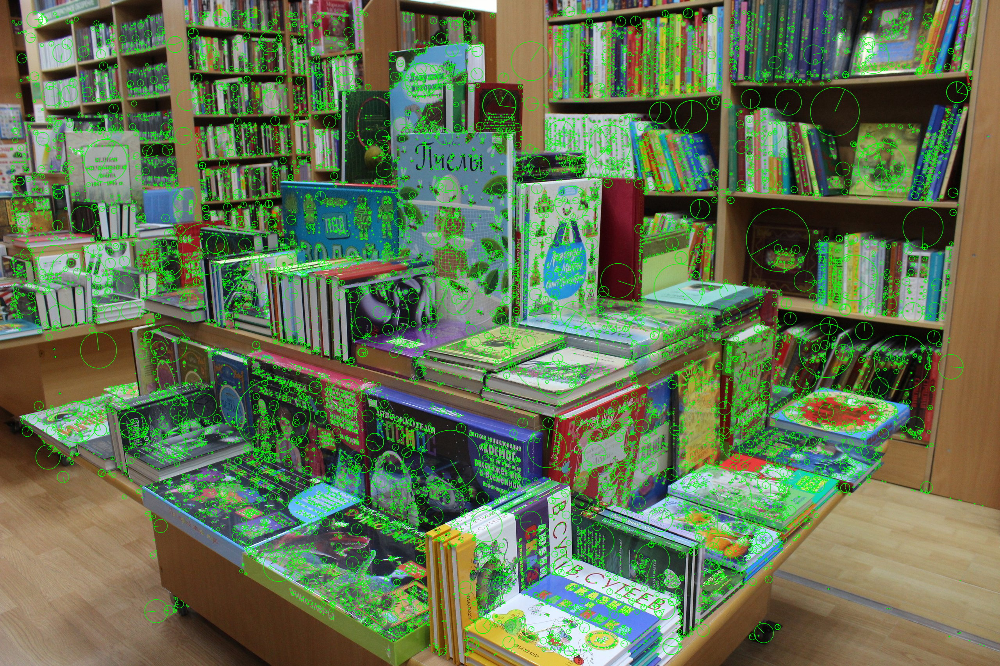

In [38]:
# Displaying SIFT feature points in green color with scale and orientation
obj_out = cv.drawKeypoints(obj_img, obj_fp, None, color = (0, 255, 0) , flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
scene_out = cv.drawKeypoints(scene_img, scene_fp, None, color = (0, 255, 0) , flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv.imwrite(img_path + obj_img_name.rpartition('.')[0] + "_sift.jpg", obj_out)
cv.imwrite(img_path + scene_img_name.rpartition('.')[0] + "_sift.jpg", scene_out)
cv2_imshow(obj_out)
cv2_imshow(scene_out)

In [42]:
# Creating brute force descriptor matcher with Hamming distance
matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=False)

In [43]:
# Finding k-nearest best match for two sets of descriptors and filtering them
# Find kNN matches with k = 2
matches = matcher.knnMatch(obj_descr, scene_descr, k = 2)
# Select good matches
knn_ratio = 0.75
good = []
for m in matches:
    if len(m) > 1:
        if m[0].distance < knn_ratio * m[1].distance:
            good.append(m[0])
matches = good

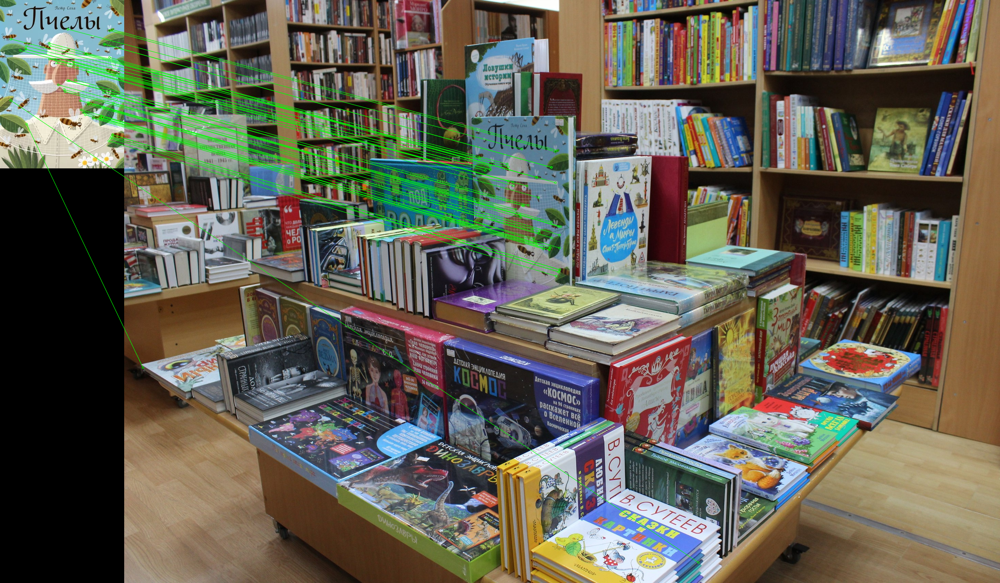

In [46]:
# Displaying top 50 matches
num_matches = 50
matches = sorted(matches, key = lambda x:x.distance)
img_match = cv.drawMatches(obj_img, obj_fp, scene_img, scene_fp, matches[:num_matches], None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS, matchColor=(0, 255, 0))
cv.imwrite(img_path + "scene_obj_1.jpg", img_match)
cv2_imshow(img_match)

In [47]:
# Executing RANSAC to calculate the transformation matrix
MIN_MATCH_COUNT = 10
if len(matches) < MIN_MATCH_COUNT:
    print("Not enough matches.")

# Create arrays of point coordinates
obj_pts = np.float32([obj_fp[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
scene_pts = np.float32([scene_fp[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

# Run RANSAC method
M, mask = cv.findHomography(obj_pts, scene_pts, cv.RANSAC, 5)
mask = mask.ravel().tolist()

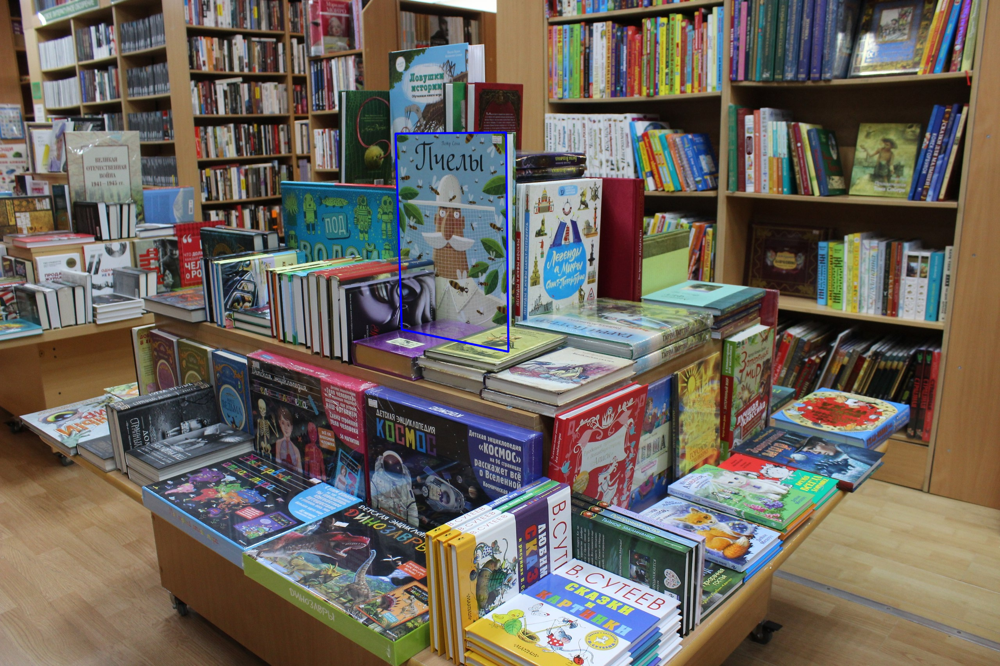

In [48]:
# Displaying the location of the first image on the second one
# Image corners
h, w = obj_img.shape[:2]
obj_box = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
obj_to_scene_box =cv.perspectiveTransform(obj_box, M)
# Draw a red box on the scene image
img_res = cv.polylines(scene_img, [np.int32(obj_to_scene_box)], True, (255, 0, 0), 3, cv.LINE_AA)
cv.imwrite(img_path + "scene_obj_1_ransac_box.jpg", img_res)
cv2_imshow(img_res)

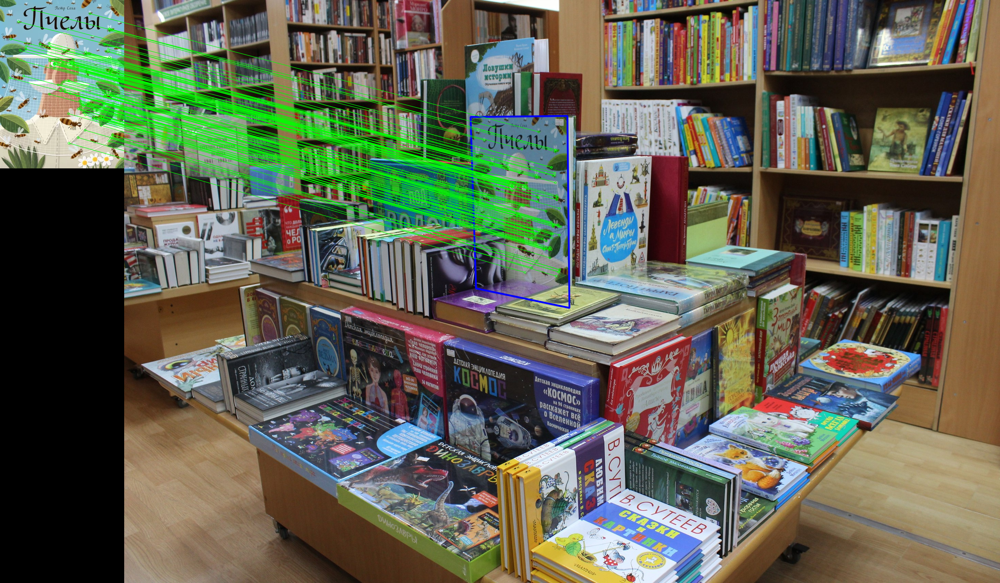

In [49]:
# Displaying inlier matches
img_trans = cv.drawMatches(obj_img, obj_fp, scene_img, scene_fp,matches, None, matchesMask=mask, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS, matchColor=(0, 255, 0))
cv.imwrite(img_path + "scene_obj_1_inliers.jpg", img_trans)
cv2_imshow(img_trans)